In [1]:
include("kim and nelson.jl")
using .julia


In [2]:
using LinearAlgebra
using Random
using Distributions
using ProgressMeter
using Statistics  
using SpecialFunctions
using NLopt

using Plots
using StatsPlots  
using DataFrames
using XLSX


## Estimate

In [3]:
# Specify the file path and sheet name
file_path = "quarterly_gdp.xlsx"
sheet_name = "Quarterly GDP"

# Open the Excel file and load the data from the specified sheet into a DataFrame
data = XLSX.readtable(file_path, sheet_name) |> DataFrame

# Display data
println(data)

# Get the number of observations
num_obs = size(data, 1)
println("Number of observations: ", num_obs)




134×2 DataFrame
 Row │ Date    Value 
     │ Any     Any   
─────┼───────────────
   1 │ 1991K1  364.6
   2 │ 1991K2  364.7
   3 │ 1991K3  368.6
   4 │ 1991K4  364.5
   5 │ 1992K1  371.5
   6 │ 1992K2  367.9
   7 │ 1992K3  377.2
   8 │ 1992K4  375.4
   9 │ 1993K1  371.8
  10 │ 1993K2  370
  11 │ 1993K3  373.2
  12 │ 1993K4  375.7
  13 │ 1994K1  385.1
  14 │ 1994K2  391.5
  15 │ 1994K3  393.3
  16 │ 1994K4  399.8
  17 │ 1995K1  404.2
  18 │ 1995K2  402.5
  19 │ 1995K3  404
  20 │ 1995K4  406.7
  21 │ 1996K1  407.8
  22 │ 1996K2  418.3
  23 │ 1996K3  419
  24 │ 1996K4  419.1
  25 │ 1997K1  424.8
  26 │ 1997K2  431.6
  27 │ 1997K3  429.7
  28 │ 1997K4  430.9
  29 │ 1998K1  437.5
  30 │ 1998K2  434
  31 │ 1998K3  441.2
  32 │ 1998K4  444.1
  33 │ 1999K1  447.8
  34 │ 1999K2  449.8
  35 │ 1999K3  451.7
  36 │ 1999K4  459.7
  37 │ 2000K1  462.9
  38 │ 2000K2  468.1
  39 │ 2000K3  468.9
  40 │ 2000K4  476.5
  41 │ 2001K1  469.1
  42 │ 2001K2  472.2
  43 │ 2001K3  475.3
  44 │ 2001K4  477.7
  

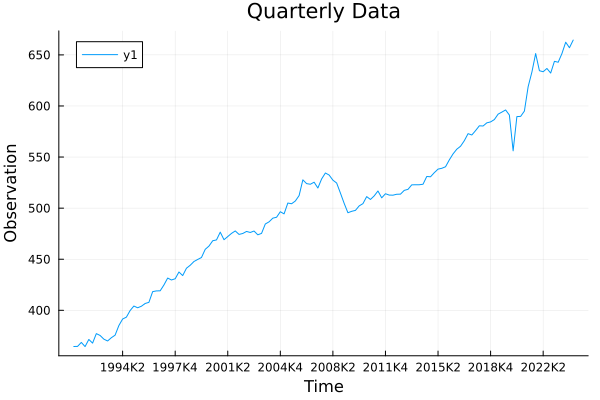

In [4]:
y = data[:, 2]
# y = log.(y)
dates = data[:, 1]

# Plot the data
plot(dates,y, title="Quarterly Data", xlabel="Time", ylabel="Observation")

In [5]:
#Define model
state_dim = 4
alpha_init = zeros(state_dim)
alpha_init[1] = y[1]
P1 = Matrix{Float64}(I(state_dim))*100  # Initial covariance matrix

#Priors

a_psi1 = 1e-6
b_psi1 = 0.97

a_psi2 = 1e-6
b_psi2 = 0.97

a_xi = 1e-6
b_xi = 1e-6

a_kappa_0 = 1e-6
b_kappa_0 = 1e-6

a_kappa_1 = 1e-6
b_kappa_1 = 1e-6

a_epsilon_0 = 3
b_epsilon_0 = 1

a_epsilon_1 = 3
b_epsilon_1 = 1

a_omega = -100
b_omega = 0

a_p = 0.01
b_p = 0.99

a_q = 0.01
b_q = 0.99

# a_sigma = 1e-6
# b_sigma = 1e-6

priors = [a_psi1, b_psi1, a_psi2, b_psi2, a_xi, b_xi, a_kappa_0, b_kappa_0, a_kappa_1, b_kappa_1, a_epsilon_0, b_epsilon_0, a_epsilon_1, b_epsilon_1, a_omega, b_omega, a_p, b_p, a_q, b_q]




20-element Vector{Float64}:
    1.0e-6
    0.97
    1.0e-6
    0.97
    1.0e-6
    1.0e-6
    1.0e-6
    1.0e-6
    1.0e-6
    1.0e-6
    3.0
    1.0
    3.0
    1.0
 -100.0
    0.0
    0.01
    0.99
    0.01
    0.99

In [6]:
# Run MCMC initialization
chain_init_burned, Sigma, acceptance_rate_init, chain_init, theta_samples_init = initialize_mcmc(
    y,
    priors,
    alpha_init, 
    P1; 
    n_init=80000, 
    burn_init=40000, 
    omega_init=0.06)

Initialization Phase 100%|███████████████████████████████| Time: 0:01:22


Initialization Acceptance Rate: 25.615 %


([1.4656472316824887 -1.4899447938864159 … 1.3856633113665102 2.5568357518717026; 1.4656472316824887 -1.4899447938864159 … 1.3856633113665102 2.5568357518717026; … ; 0.7298282650415895 -0.7857119737771032 … 0.9446191538449907 4.580823440597733; 0.7298282650415895 -0.7857119737771032 … 0.9446191538449907 4.580823440597733], [0.6532832440739703 -0.32764136924830206 … -0.060644476687022976 -0.12778061992142806; -0.32764136924830206 0.35818430776462945 … 0.1045996293124787 0.04169830896274591; … ; -0.060644476687022976 0.1045996293124787 … 0.7744277411104377 0.10762874919701919; -0.12778061992142806 0.04169830896274591 … 0.10762874919701919 0.9519653422814218], 0.25615, [0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; 0.7298282650415895 -0.7857119737771032 … 0.9446191538449907 4.580823440597733; 0.7298282650415895 -0.7857119737771032 … 0.9446191538449907 4.580823440597733], [0.7880232260276849 0.1784129293585226 … 0.7939010326659606 0.9194707782986971; 0.7880232260276849 0.1784129293585226 … 0.7

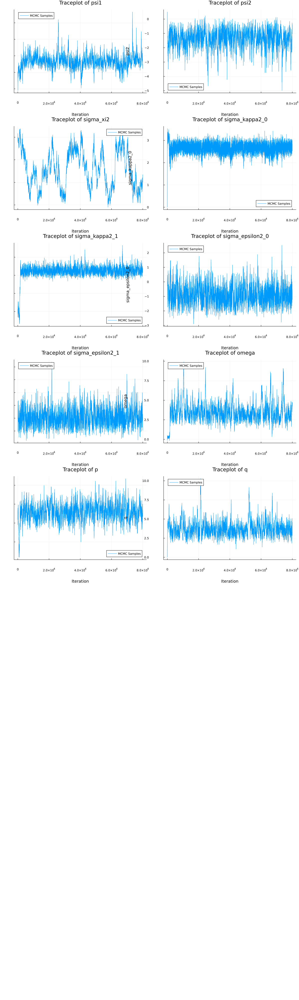

In [7]:
parameters = ["psi1", "psi2", "sigma_xi2", "sigma_kappa2_0", "sigma_kappa2_1",
              "sigma_epsilon2_0", "sigma_epsilon2_1", "omega", "p", "q"]

n_params = length(parameters)

# Initialize a list to hold the plots
p_list = []

for i in 1:n_params
    param_samples_init = chain_init[:, i]
    
    # Traceplot of MCMC samples
    p2 = plot(param_samples_init, label="MCMC Samples", xlabel="Iteration", ylabel=parameters[i],
              title="Traceplot of $(parameters[i])")

    
    # Add plots to the list
    push!(p_list, p2)
end

# Display the plots in a grid layout
nrows = n_params
ncols = 2
plot(p_list..., layout=(nrows, ncols), size=(1200, 400 * n_params))


In [8]:
# Run MCMC recursion
theta_samples_burned, alpha_samples, acceptance_rate_rec, p_res = recursion_mcmc(
    y, 
    priors,
    alpha_init, 
    P1, 
    chain_init_burned,
    Sigma; 
    n_rec=40000, 
    burn_rec=20000, 
    omega_rec=0.1)


Recursion Phase 100%|████████████████████████████████████| Time: 0:01:11K


Recursion Acceptance Rate: 43.762499999999996 %


([0.7696557880168021 0.20048135703754216 … 0.7211980443931721 0.9504900494696611; 0.7692001433627794 0.18781079724350502 … 0.6941018347905554 0.9468159446603163; … ; 0.8256237552422202 0.16924683605022076 … 0.6459959441219116 0.953603278681213; 0.8256237552422202 0.16924683605022076 … 0.6459959441219116 0.953603278681213], Any[[365.0120964556936 0.20567285740122251 -0.412096455693525 0.15752056889427196; 365.1792501585862 0.25751758660869417 -0.4792501585862312 -0.32112716067361996; … ; 662.2131906615597 2.2480555939143967 -5.213190661559756 2.3894466367965483; 667.152558302702 2.2701910289760865 -2.6525583027019737 -7.8498665075881515], [365.0329859792912 0.21602128873063536 -0.43298597929116484 0.16626203520638227; 365.1788210524353 0.2568874449379004 -0.4788210524352635 -0.3211828589933965; … ; 655.6777381272652 2.1943491966167126 1.3222618727348543 8.844906477793323; 660.2754537075253 2.2141564900971966 4.224546292474495 -1.0069343943420643], [364.9813775984511 0.18997885497097902 

In [9]:


# Number of optimization runs
num_runs = 1

# Parameter names to associate with priors
parameters = ["psi1", "psi2", "sigma_xi2", "sigma_kappa2_0", "sigma_kappa2_1",
              "sigma_epsilon2_0", "sigma_epsilon2_1", "omega", "p", "q"]

upper_bounds = [1.0, π, Inf, Inf, Inf, Inf, Inf, Inf, 1.0, 1.0]
lower_bounds = [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -Inf, 0.0, 0.0]

              
# Function to generate initial parameters from specified priors
function draw_initial_params(parameters)
    initial_params = Float64[]  # Enforce Float64 type for the parameters
    for param in parameters
        if param == "psi1"
            push!(initial_params, rand(Uniform(a_psi1, b_psi1)))
        elseif param == "psi2"
            push!(initial_params, rand(Uniform(a_psi2, b_psi2)))
        elseif param in ["p", "q"]
            # Uniform prior between 0 and 1
            push!(initial_params, rand(Uniform(a_p, b_p)))
        elseif param == "omega"
            # Normal prior
            push!(initial_params, rand(Normal(-10, 1)))
        else
            # Inverse-Gamma prior
            push!(initial_params, rand(InverseGamma(3, 1)))
        end
    end
    return initial_params
end

# Define the objective function
function obj(params::Vector, grad::Vector)
    try
        return neg_log_likelihood(params, y, alpha_init, P1, n_order)
    catch e
        return 1e10  # Return a large number in case of error
    end
end

# Run optimization with multiple initial guesses

best_minf = Inf
best_params = nothing

pb = Progress(num_runs; desc="MLE Optimization")
for run in 1:num_runs
    
    # Draw a new set of initial parameters from priors
    initial_params = draw_initial_params(parameters)

    # Create the optimizer
    opt = Opt(:LN_NELDERMEAD, length(initial_params))
    opt.lower_bounds = lower_bounds
    opt.upper_bounds = upper_bounds
    opt.min_objective = obj
    opt.maxeval = 100000
    opt.xtol_rel = 1e-6

    # Run the optimization
    (minf, estimated_params, ret) = NLopt.optimize(opt, initial_params)
 
    # Save the best result
    if minf < best_minf
        best_minf = minf
        best_params = estimated_params
    end

    next!(pb)
end


# Display the best estimated parameters
println("Best Estimated Parameters: ", best_params)


Best Estimated Parameters: [0.6434177906994564, 0.0046128425894021614, 1.6118974956292238, 0.3574416066029793, 1.572138263566293, 0.5197210159256564, 0.4306997613292691, -9.479132433321027, 0.7768176449974813, 0.5037524844808489]


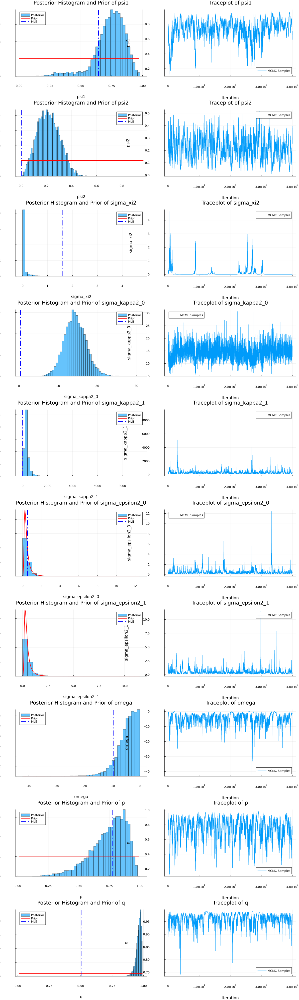

In [10]:
# Initialize a list to hold the plots
p_list = []

for i in 1:n_params
    # param_samples = theta_samples_burned[:, i]
    param_samples = theta_samples_init[:,i]
    
    # Histogram of posterior samples
    p1 = histogram(param_samples, bins=50, normalize=true, alpha=0.6,
                   label="Posterior", xlabel=parameters[i], ylabel="Density",
                   title="Posterior Histogram and Prior of $(parameters[i])")
    
    # Define the prior distribution
    if parameters[i] == "psi1"
        # Uniform prior between 0 and 0.999
        a = a_psi1
        b = b_psi1
        x_values = range(a, b, length=200)
        prior_pdf = pdf.(Uniform(a, b), x_values)
    elseif parameters[i] == "psi2"
        # Uniform prior 
        a = a_psi2
        b = b_psi2
        x_values = range(a, b, length=200)
        prior_pdf = pdf.(Uniform(a, b), x_values)
    elseif parameters[i] in ["p", "q"]
        # Uniform prior between 0 and 1
        a = a_p
        b = 1b_p
        x_values = range(a, b, length=200)
        prior_pdf = pdf.(Uniform(a, b), x_values)
    elseif parameters[i] == "omega"
        a = a_omega
        b = b_omega
        x_values = range(minimum(param_samples), maximum(param_samples), length=200)
        prior_pdf = pdf.(Normal(a, b), x_values)
    elseif parameters[i] == "sigma_xi2"
        a = a_xi
        b = b_xi
        x_values = range(0, maximum(param_samples), length=200)
        prior_pdf = pdf.(InverseGamma(a, b), x_values)
    elseif parameters[i] == "sigma_kappa2_0"
        a = a_kappa_0
        b = b_kappa_0
        x_values = range(0, maximum(param_samples), length=200)
        prior_pdf = pdf.(InverseGamma(a, b), x_values)
    elseif parameters[i] == "sigma_kappa2_1"
        a = a_kappa_1
        b = b_kappa_1
        x_values = range(0, maximum(param_samples), length=200)
        prior_pdf = pdf.(InverseGamma(a, b), x_values)
    elseif parameters[i] == "sigma_epsilon2_0"
        a = a_epsilon_0
        b = b_epsilon_0
        x_values = range(0, maximum(param_samples), length=200)
        prior_pdf = pdf.(InverseGamma(a, b), x_values)
    elseif parameters[i] == "sigma_epsilon2_1"
        a = a_epsilon_1
        b = b_epsilon_1
        x_values = range(0, maximum(param_samples), length=200)
        prior_pdf = pdf.(InverseGamma(a, b), x_values)
    elseif parameters[i] == "sigma_y"
        a = a_sigma
        b = b_sigma
        x_values = range(0, maximum(param_samples), length=200)
        prior_pdf = pdf.(InverseGamma(a, b), x_values)
    
    end
    
    # Overlay prior PDF on histogram
    plot!(p1, x_values, prior_pdf, label="Prior", color=:red, linewidth=2)

    #MLE estimates
    vline!(p1, [best_params[i]], label="MLE", color=:blue, linestyle=:dashdot, linewidth=2)
    
    # Traceplot of MCMC samples
    p2 = plot(param_samples, label="MCMC Samples", xlabel="Iteration", ylabel=parameters[i],
              title="Traceplot of $(parameters[i])")
    
 
    
    # Add plots to the list
    push!(p_list, p1)
    push!(p_list, p2)
end

# Display the plots in a grid layout
nrows = n_params
ncols = 2
plot(p_list..., layout=(nrows, ncols), size=(1200, 400 * n_params))


In [11]:
# Calculate means of posterior samples
chain_rec_burned_means = mean(theta_samples_burned, dims=1)  # 1 x n_params array
chain_rec_burned_means = vec(chain_rec_burned_means)  # Convert to a vector


10-element Vector{Float64}:
   0.7538931867016764
   0.22244044130449184
   0.0455863313646454
  14.597739209531579
 312.594768306964
   0.4862027456174146
   0.4619250115452059
  -4.099634055773774
   0.7327215064238677
   0.9596358135408216

In [12]:

# Create the DataFrame
data = DataFrame(Dict(
    "Parameter" => parameters,
    "MCMC Estimate" => chain_rec_burned_means,
    "MLE Estimate" => best_params,  # Include if available
))

# Display the DataFrame
display(data)


Row,MCMC Estimate,MLE Estimate,Parameter
,Float64,Float64,String
1,0.753893,0.643418,psi1
2,0.22244,0.00461284,psi2
3,0.0455863,1.6119,sigma_xi2
4,14.5977,0.357442,sigma_kappa2_0
5,312.595,1.57214,sigma_kappa2_1
6,0.486203,0.519721,sigma_epsilon2_0
7,0.461925,0.4307,sigma_epsilon2_1
8,-4.09963,-9.47913,omega
9,0.732722,0.776818,p


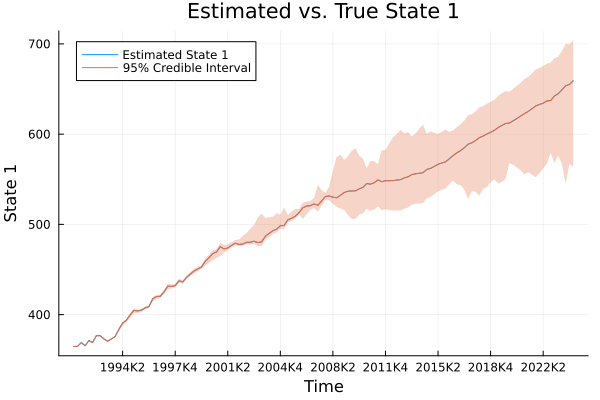

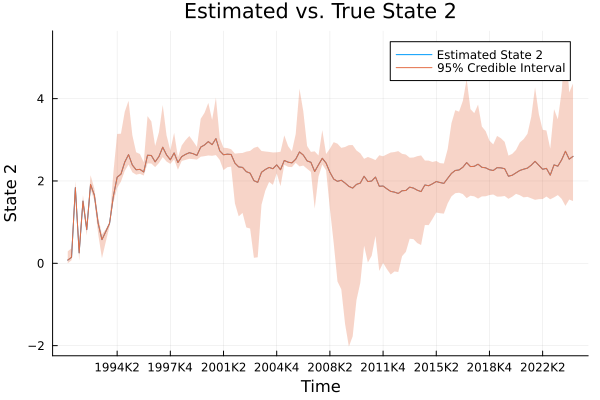

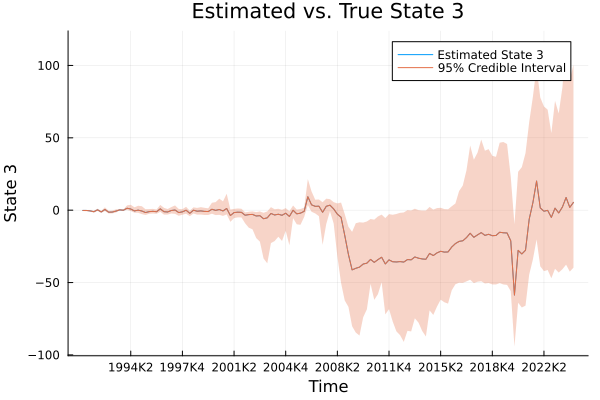

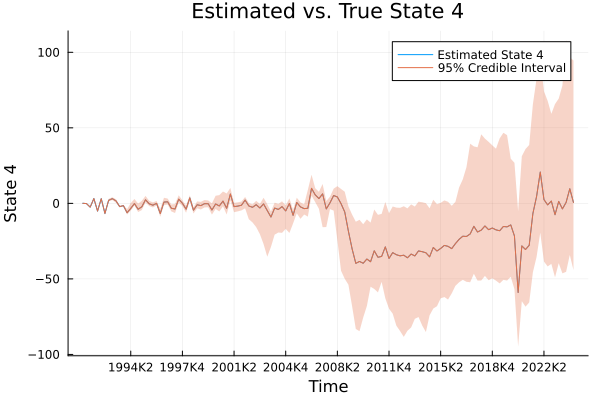

134
134


In [13]:
# Collect alpha samples into a 3D array
n_samples = length(alpha_samples)
n_time_steps = size(alpha_samples[1], 1)
state_dim = size(alpha_samples[1], 2)

dates_plot = dates

println(n_time_steps)
println(length(dates_plot))

# Initialize array to hold alpha samples
alpha_samples_array = Array{Float64}(undef, n_samples, n_time_steps, state_dim)

for i in 1:n_samples
    alpha_samples_array[i, :, :] = alpha_samples[i]
end


# Compute posterior mean over samples (dimension 1)
alpha_mean = mean(alpha_samples_array, dims=1)  # 1 x n_time_steps x state_dim
alpha_mean = dropdims(alpha_mean; dims=1)  # n_time_steps x state_dim

# Compute credible intervals
alpha_lower = mapslices(x -> quantile(x, 0.025), alpha_samples_array; dims=1)
alpha_lower = dropdims(alpha_lower; dims=1)
alpha_upper = mapslices(x -> quantile(x, 0.975), alpha_samples_array; dims=1)
alpha_upper = dropdims(alpha_upper; dims=1)



time = 1:n_time_steps

for s in 1:state_dim
    p = plot(dates_plot, alpha_mean[:, s], label="Estimated State $(s)", xlabel="Time",
             ylabel="State $(s)", title="Estimated vs. True State $(s)")
    
    # Add credible intervals using the `ribbon` argument
    plot!(dates_plot, alpha_mean[:, s], ribbon=(alpha_mean[:, s] .- alpha_lower[:, s],
          alpha_upper[:, s] .- alpha_mean[:, s]), fillalpha=0.3, label="95% Credible Interval")
    
    # # Plot true state (assuming you have `alpha_true` from data simulation)
    # plot!(time, alpha[1:n_time_steps, s], label="True State $(s)", linestyle=:dash, color=:red)
    
    display(p)
end


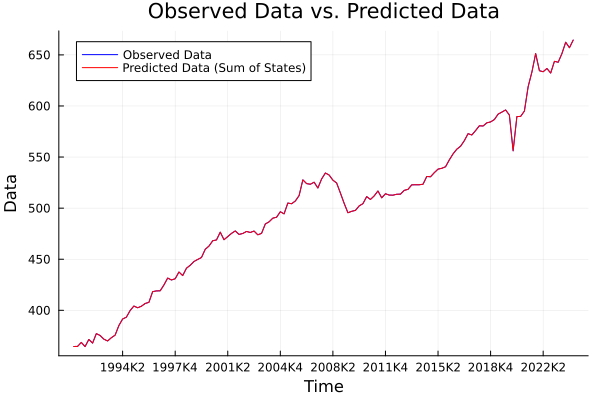

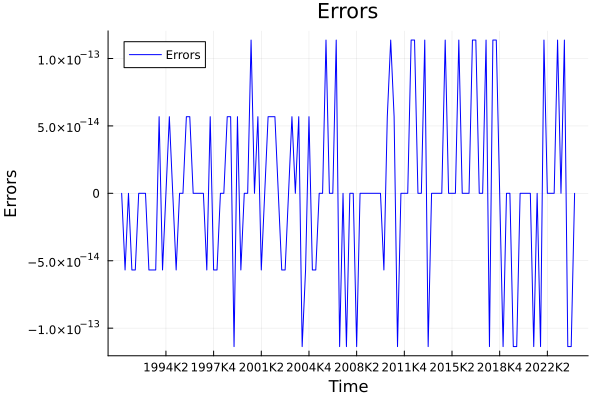

In [14]:
# Compute y_pred
state_indices = [1, 3]  

y_pred = alpha_mean[:, state_indices[1]] .+ alpha_mean[:, state_indices[2]]

time = 1:length(y_pred)
y_adjusted = y

p = plot(dates_plot, y_adjusted, label="Observed Data", color=:blue)
plot!(p, dates_plot, y_pred, label="Predicted Data (Sum of States)", color=:red)
xlabel!("Time")
ylabel!("Data")
title!("Observed Data vs. Predicted Data")
display(p)


errors = y_adjusted .- y_pred

p_error = plot(dates_plot, errors, label="Errors", color=:blue)
xlabel!("Time")
ylabel!("Errors")
title!("Errors")
display(p_error)


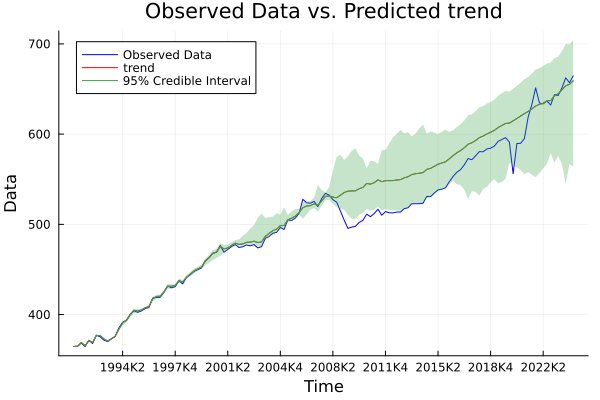

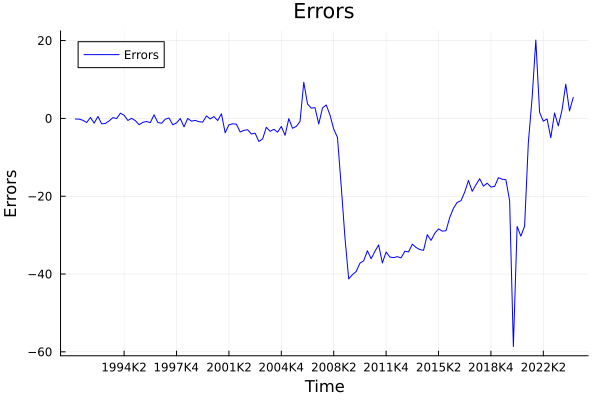

In [20]:
# estimated state 1 and true observation y
# Compute y_pred
state_indices = [1, 3]  

y_pred = alpha_mean[:, state_indices[1]] 

time = 1:length(y_pred)
y_adjusted = y[1:length(y_pred)]  # Adjust if lengths differ

p = plot(dates_plot, y_adjusted, label="Observed Data", color=:blue)
plot!(p, dates_plot, y_pred, label="trend", color=:red)
xlabel!("Time")
ylabel!("Data")
title!("Observed Data vs. Predicted trend")

# Add credible intervals using the `ribbon` argument
plot!(dates_plot, y_pred, ribbon=(alpha_mean[:, state_indices[1]] .- alpha_lower[:, state_indices[1]],
      alpha_upper[:, state_indices[1]] .- alpha_mean[:, state_indices[1]]), fillalpha=0.3, label="95% Credible Interval")

display(p)

errors = y_adjusted .- y_pred

p_error = plot(dates_plot, errors, label="Errors", color=:blue)
xlabel!("Time")
ylabel!("Errors")
title!("Errors")
display(p_error)





## Graphs from MLE estimates


In [16]:
logL, a_mle, p_res_mle = switching_kalman_filter(y, best_params, n_order, alpha_init, P1)

UndefVarError: UndefVarError: `n_order` not defined

In [17]:
println(size(a_mle))

UndefVarError: UndefVarError: `a_mle` not defined

In [18]:
# Collect alpha samples into a 3D array
n_time_steps = size(alpha_samples[1])
state_dim = size(alpha_samples[2])

dates_plot = dates

p = plot(dates_plot, a_mle[:,1], label="Estimated State ", xlabel="Time",
             ylabel="State ", title="Estimated vs. True State ")
    
    
display(p)



UndefVarError: UndefVarError: `a_mle` not defined